# Visualize VGG19 class activation heatmaps

In [1]:
import cv2
from google.colab.patches import cv2_imshow
%matplotlib inline
from matplotlib import pyplot as plt
import numpy as np
from keras import backend as K

from keras.applications.vgg19 import VGG19
# note that we keep the densely connected classifier;
# in the two previous vizualization methods, we discarded it

from keras.preprocessing import image
from keras.applications.vgg19 import preprocess_input, decode_predictions

from keras import models
from google.colab import files
from keras.models import load_model

Using TensorFlow backend.


In [2]:
!wget https://github.com/Stnslv/ML-Homeworks/blob/master/HW3/dog1.jpg?raw=true \
  -O dog1.jpg
  
!wget https://github.com/Stnslv/ML-Homeworks/blob/master/HW3/dog2.jpg?raw=true \
  -O dog2.jpg

!wget https://github.com/Stnslv/ML-Homeworks/blob/master/HW3/dog3.jpg?raw=true \
  -O dog3.jpg
  
!wget https://github.com/Stnslv/ML-Homeworks/blob/master/HW3/wolf.jpg?raw=true \
  -O wolf.jpg
  
!wget https://github.com/Stnslv/ML-Homeworks/blob/master/HW3/cat1.jpg?raw=true \
  -O cat1.jpg
  
!wget https://github.com/Stnslv/ML-Homeworks/blob/master/HW3/cat2.jpg?raw=true \
  -O cat2.jpg
  
!wget https://github.com/Stnslv/ML-Homeworks/blob/master/HW3/cat3.jpg?raw=true \
  -O cat3.jpg
  
!wget https://github.com/Stnslv/ML-Homeworks/blob/master/HW3/lion.jpg?raw=true \
  -O lion.jpg

--2019-04-20 00:50:07--  https://github.com/Stnslv/ML-Homeworks/blob/master/HW3/dog1.jpg?raw=true
Resolving github.com (github.com)... 192.30.255.112, 192.30.255.113
Connecting to github.com (github.com)|192.30.255.112|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://github.com/Stnslv/ML-Homeworks/raw/master/HW3/dog1.jpg [following]
--2019-04-20 00:50:08--  https://github.com/Stnslv/ML-Homeworks/raw/master/HW3/dog1.jpg
Reusing existing connection to github.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/Stnslv/ML-Homeworks/master/HW3/dog1.jpg [following]
--2019-04-20 00:50:08--  https://raw.githubusercontent.com/Stnslv/ML-Homeworks/master/HW3/dog1.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting

In [3]:
model = VGG19(weights='imagenet') 
last_conv_layer = model.get_layer('block5_conv4')


Instructions for updating:
Colocations handled automatically by placer.
574717952/574710816 [==============================] - 30s 0us/step


In [0]:
# Get 4 dogs.
dog1 = 'dog1.jpg'
dog2 = 'dog2.jpg'
dog3 = 'dog3.jpg'
wolf = 'wolf.jpg'

# Get 4 cats.
cat1 = 'cat1.jpg'
cat2 = 'cat2.jpg'
cat3 = 'cat3.jpg'
lion = 'lion.jpg'

In [0]:
def show_superimposed_image(img_path, heatmap):

  img = cv2.imread(img_path)
  # resize the heatmap to be the same size as the original image
  heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))

  heatmap = np.uint8(255 * heatmap)

  heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

  superimposed_img = heatmap * 0.4 + img

  cv2_imshow(superimposed_img)

In [0]:
def process_image(img_path, idx=0):
  img = image.load_img(img_path, target_size=(224, 224))
  
  plt.imshow(img)
  plt.grid(None)
  plt.show()
  
  x = image.img_to_array(img)
  x = np.expand_dims(x, axis=0)
  x = preprocess_input(x)
  
  preds = model.predict(x)
  print('Predicted:', decode_predictions(preds, top=3)[0])
  
  class_index = np.argsort(preds[0])[-(1+idx)]
  
  class_output = model.output[:, class_index]
  
  grads = K.gradients(class_output, last_conv_layer.output)[0]

  pooled_grads = K.mean(grads, axis=(0, 1, 2))

  iterate = K.function([model.input], [pooled_grads, last_conv_layer.output[0]])

  pooled_grads_value, conv_layer_output_value = iterate([x])

  for i in range(512):
    conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

  heatmap = np.mean(conv_layer_output_value, axis=-1)
  
  heatmap = np.maximum(heatmap, 0)
  heatmap /= np.max(heatmap)

  plt.matshow(heatmap)
  plt.grid(None)
  plt.show()
  
  show_superimposed_image(img_path, heatmap)

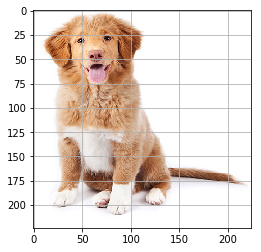

40960/35363 [==================================] - 0s 4us/step
Predicted: [('n02099601', 'golden_retriever', 0.40633622), ('n02099849', 'Chesapeake_Bay_retriever', 0.19888793), ('n02101388', 'Brittany_spaniel', 0.17420524)]


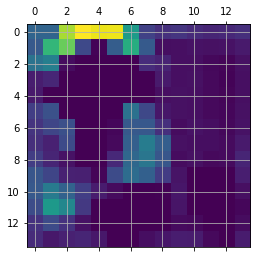

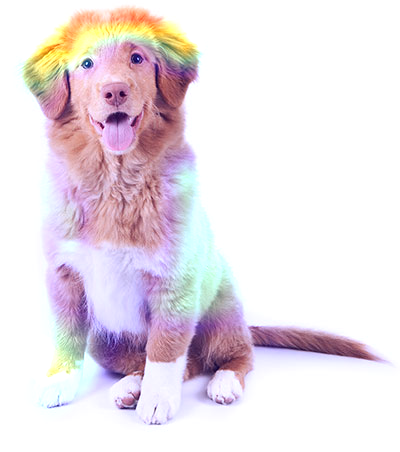

In [7]:
process_image(dog1)

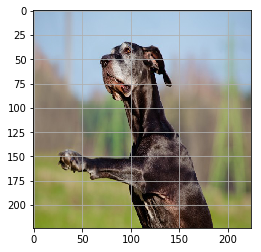

Predicted: [('n02109047', 'Great_Dane', 0.42186052), ('n02100236', 'German_short-haired_pointer', 0.29829097), ('n02099712', 'Labrador_retriever', 0.060451064)]


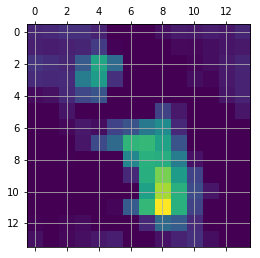

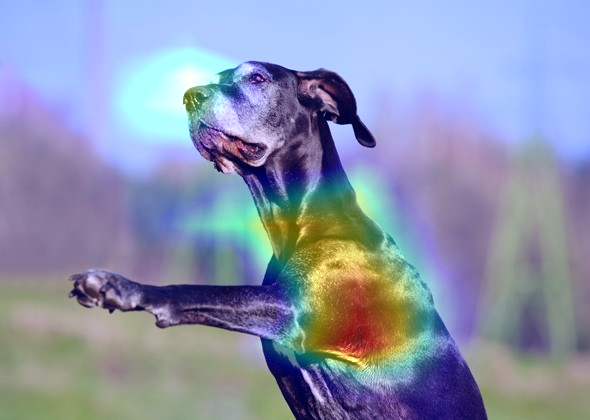

In [8]:
process_image(dog2)

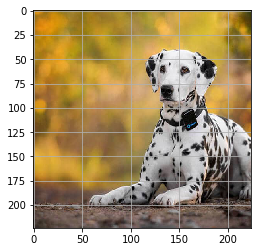

Predicted: [('n02110341', 'dalmatian', 0.9915133), ('n02109047', 'Great_Dane', 0.007982464), ('n02091134', 'whippet', 7.434573e-05)]


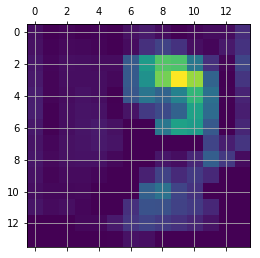

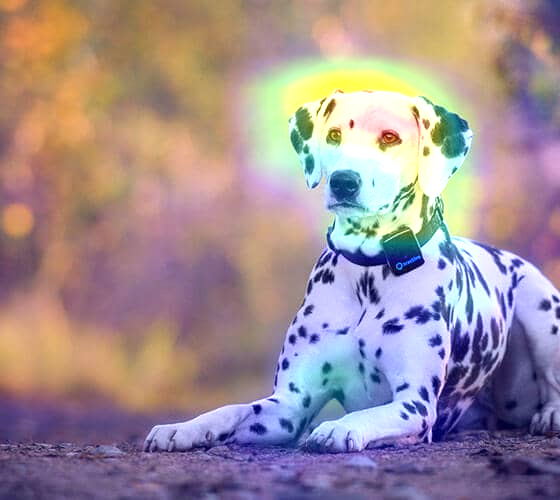

In [9]:
process_image(dog3)

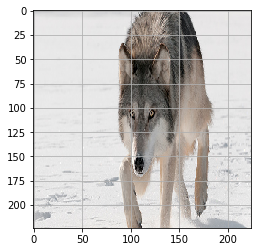

Predicted: [('n02114367', 'timber_wolf', 0.87087196), ('n02114548', 'white_wolf', 0.057228845), ('n02114855', 'coyote', 0.028665185)]


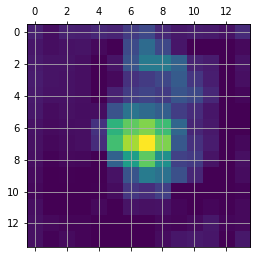

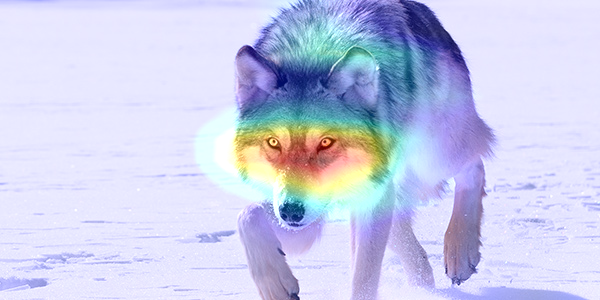

In [10]:
process_image(wolf)

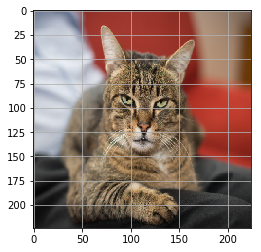

Predicted: [('n02124075', 'Egyptian_cat', 0.38435856), ('n02123159', 'tiger_cat', 0.28003487), ('n02123045', 'tabby', 0.25248015)]


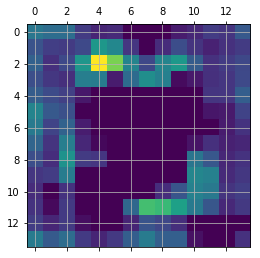

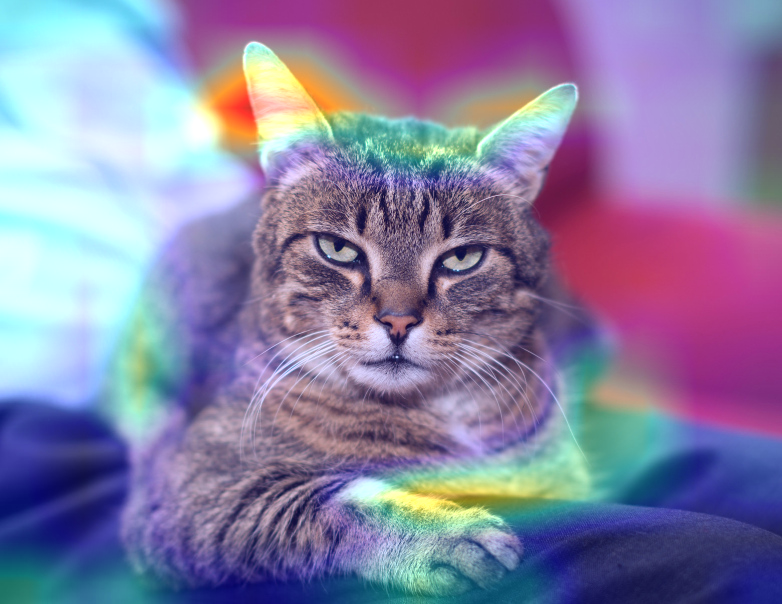

In [11]:
process_image(cat1)

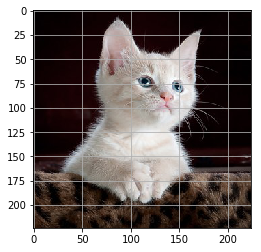

Predicted: [('n02124075', 'Egyptian_cat', 0.49403682), ('n02123045', 'tabby', 0.22019891), ('n02123159', 'tiger_cat', 0.09278933)]


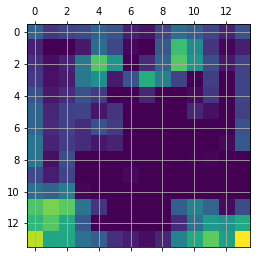

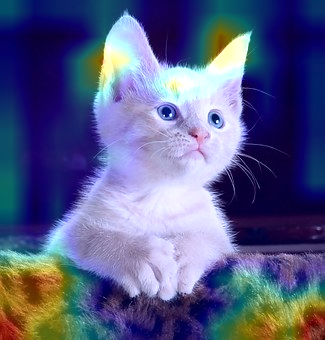

In [12]:
process_image(cat2)

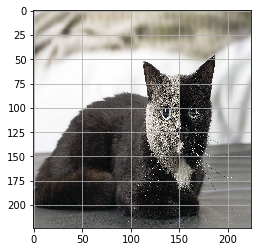

Predicted: [('n02124075', 'Egyptian_cat', 0.3549847), ('n02123045', 'tabby', 0.17493543), ('n02127052', 'lynx', 0.07302694)]


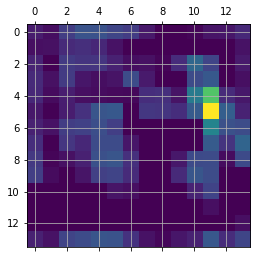

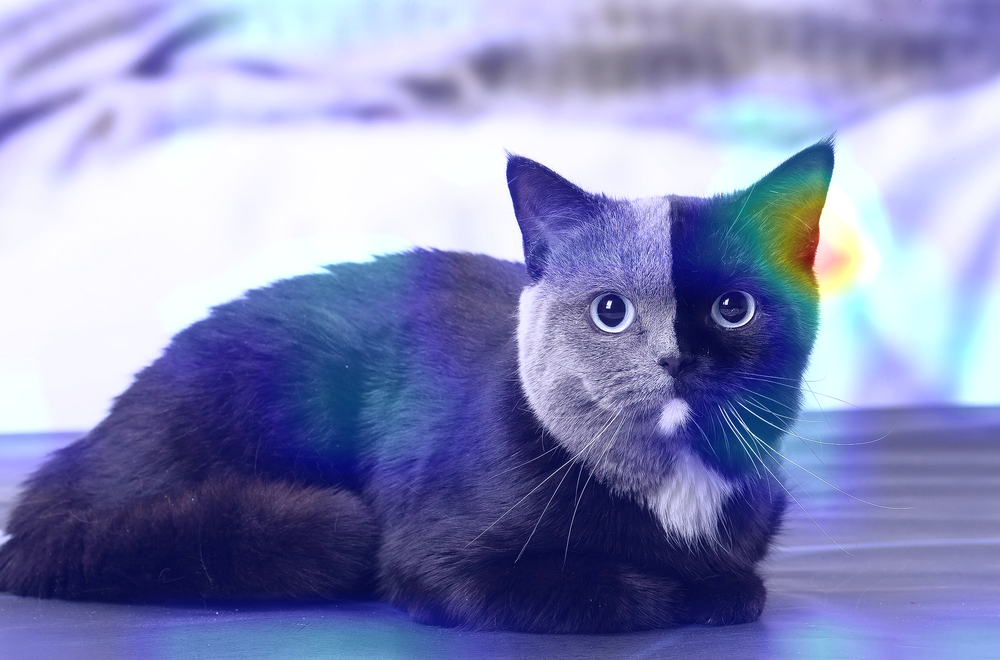

In [13]:
process_image(cat3)

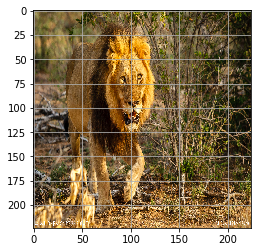

Predicted: [('n02129165', 'lion', 0.99374914), ('n02410509', 'bison', 0.000901136), ('n02397096', 'warthog', 0.0007271751)]


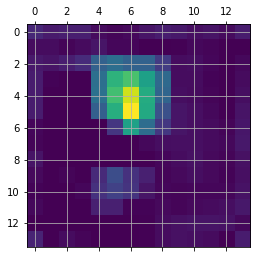

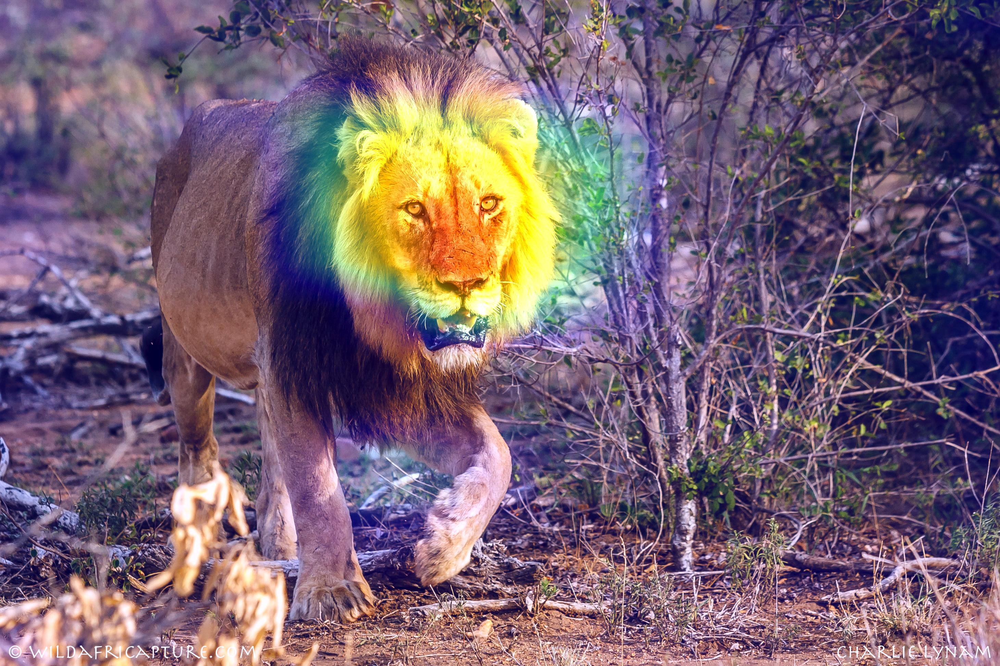

In [14]:
process_image(lion)